In [ ]:
#Imports
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import scipy

In [ ]:
# Provided code for plotting inlier matches between two images

def plot_inlier_matches(ax, img1, img2, inliers):
    """
    Plot the matches between two images according to the matched keypoints
    :param ax: plot handle
    :param img1: left image
    :param img2: right image
    :inliers: x,y in the first image and x,y in the second image (Nx4)
    """
    res = np.hstack([img1, img2])
    ax.set_aspect('equal')
    ax.imshow(res, cmap='gray')

    ax.plot(inliers[:,0], inliers[:,1], '+r')
    ax.plot(inliers[:,2] + img1.shape[1], inliers[:,3], '+r')
    ax.plot([inliers[:,0], inliers[:,2] + img1.shape[1]],
            [inliers[:,1], inliers[:,3]], 'r', linewidth=0.4)
    ax.axis('off')

# Usage:
# fig, ax = plt.subplots(figsize=(20,10))
# plot_inlier_matches(ax, img1, img2, computed_inliers)

1. RANSAC-based Image Stitching



In [ ]:
#Load both images
image1 = cv2.imread('parliament-left.jpg')
image2 = cv2.imread('parliament-right.jpg')

In [ ]:
#Get the dimension difference between image1 and image2
height_diff = image1.shape[0] - image2.shape[0]
width_diff = image1.shape[1] - image2.shape[1]

#Calculate the padding values
top_pad = height_diff // 2
bottom_pad = height_diff - top_pad
left_pad = width_diff // 2
right_pad = width_diff - left_pad

#Pad the second image to match the size of the first image
image2 = np.pad(image2, ((top_pad, bottom_pad), (left_pad, right_pad), (0, 0)), mode='constant')

In [ ]:
#Convert images to grayscale
gray_image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
gray_image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

#cv2_imshow(gray_image1)
#cv2_imshow(gray_image2)
#cv2.waitKey(0)
#cv2.destroyAllWindows()

In [ ]:
#Detect keypoints in both images
sift = cv2.SIFT_create()
keypoints1, descriptors1 = sift.detectAndCompute(gray_image1, None)
keypoints2, descriptors2 = sift.detectAndCompute(gray_image2, None)

In [ ]:
#Display the keypoints of both images
img1_keypoints_visual=cv2.drawKeypoints(gray_image1,keypoints1,image1,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('sift_keypoints1.jpg',img1_keypoints_visual)
img2_keypoints_visual=cv2.drawKeypoints(gray_image2,keypoints2,image2,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('sift_keypoints2.jpg',img2_keypoints_visual)

In [ ]:
#Reload both images
image1_new = cv2.imread('parliament-left.jpg')
image2_new = cv2.imread('parliament-right.jpg')

In [ ]:
#Get the dimension difference between image1_new and image2_new
height_diff = image1_new.shape[0] - image2_new.shape[0]
width_diff = image1_new.shape[1] - image2_new.shape[1]

#Calculate the padding values
top_pad = height_diff // 2
bottom_pad = height_diff - top_pad
left_pad = width_diff // 2
right_pad = width_diff - left_pad

#Pad the second image to match the size of the first image
image2_new = np.pad(image2_new, ((top_pad, bottom_pad), (left_pad, right_pad), (0, 0)), mode='constant')

In [ ]:
#Compute the euclidean distance between the pairs of nodes
distances = scipy.spatial.distance.cdist(descriptors1, descriptors2, 'sqeuclidean')

#Find the indices of the closest 100 pairs
sorted_indices = np.argsort(distances, axis=None)
top_indices = np.unravel_index(sorted_indices[:100], distances.shape)

#Store the closest 100 pairs in computed_inliers array
computed_inliers = np.zeros((100, 4))
for i in range(100):
    idx1 = top_indices[0][i]
    idx2 = top_indices[1][i]
    kp1 = keypoints1[idx1].pt
    kp2 = keypoints2[idx2].pt
    computed_inliers[i] = [kp1[0], kp1[1], kp2[0], kp2[1]]

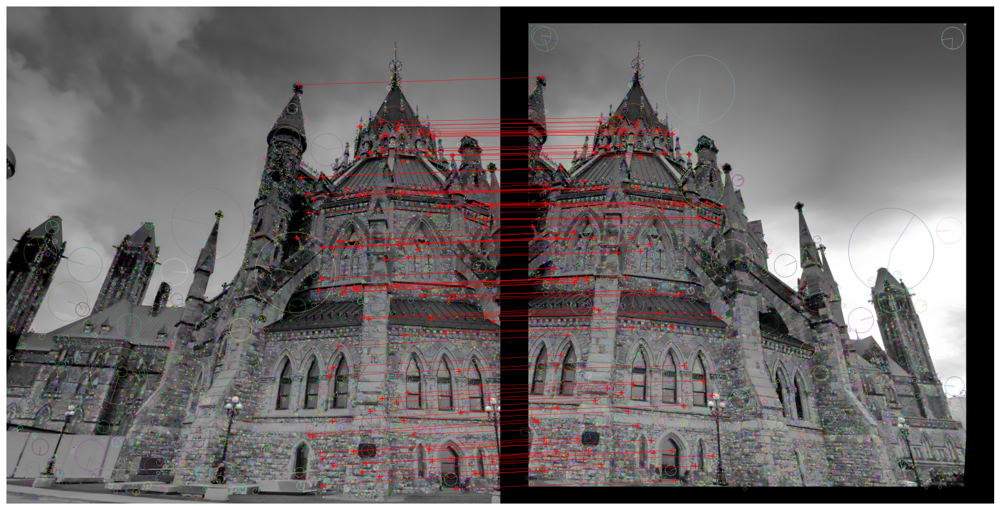

In [ ]:
# Create a figure and axis for plotting
fig, ax = plt.subplots(figsize=(20, 10))

# Plot the inlier matches using the computed_inliers array
#plot_inlier_matches(ax, gray_image1, gray_image2, computed_inliers)
#plot_inlier_matches(ax, image1, image2, computed_inliers)
plot_inlier_matches(ax, img1_keypoints_visual, img2_keypoints_visual, computed_inliers)

# Show the plot
plt.show()

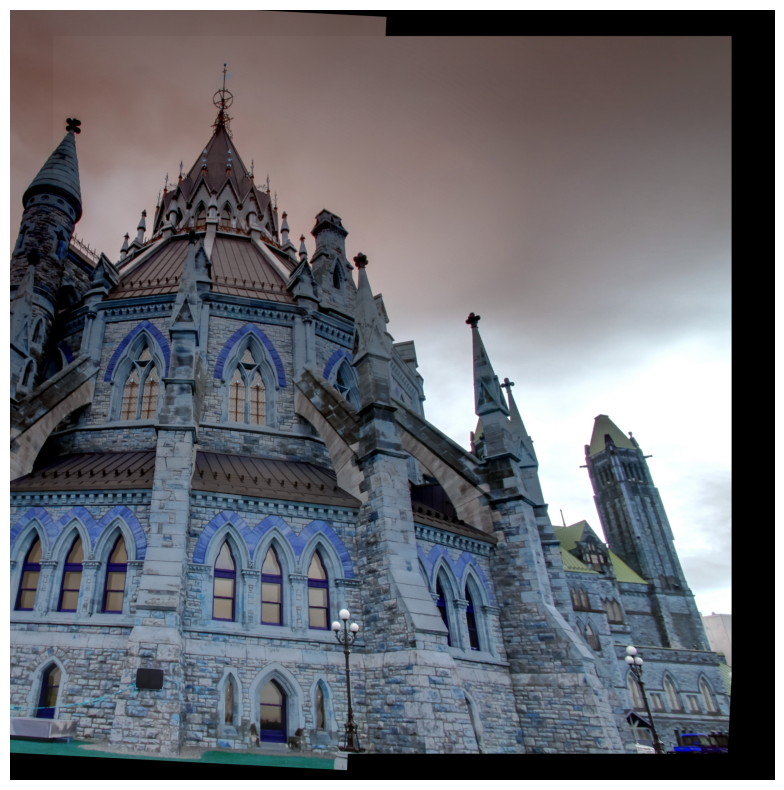

In [ ]:
#RANSAC parameters
ransac_iterations = 1000
radius_threshold = 5

#RANSAC for affine transformation estimation
best_model = None
best_inliers = 0

for _ in range(ransac_iterations):
    #Randomly select minimum subset of points
    subset_indices = np.random.choice(100, size=3, replace=False)
    subset_matches = computed_inliers[subset_indices]

    #Estimate affine transformation
    num_points = subset_matches.shape[0]
    A = np.zeros((2 * num_points, 6))
    b = np.zeros((2 * num_points, 1))
    for i in range(num_points):
        x1, y1, x2, y2 = subset_matches[i]
        A[2 * i] = [x1, y1, 1, 0, 0, 0]
        A[2 * i + 1] = [0, 0, 0, x1, y1, 1]
        b[2 * i] = x2
        b[2 * i + 1] = y2
    params, _, _, _ = np.linalg.lstsq(A, b, rcond=None)
    params = np.append(params, [[0], [0], [1]])

    #Reshape params to a 2D array
    params = params.reshape(3, 3)

    #Apply transformation to all points
    homogenous_points = np.hstack([computed_inliers[:, :2], np.ones((100, 1))])
    transformed_points = np.dot(homogenous_points, params.T)
    errors = np.linalg.norm(transformed_points[:, :2] - computed_inliers[:, 2:], axis=1)
    inliers = np.sum(errors < radius_threshold)

    if inliers > best_inliers:
        best_model = params
        best_inliers = inliers

#Warp the second image onto the first using the estimated transformation
warped_image1 = cv2.warpAffine(image1_new, best_model[:2, :], (image2.shape[1], image2.shape[0]))

#Create a new image large enough to hold the mosaic
panorama = np.maximum(warped_image1, image2_new)

#Display the color mosaic result
fig, ax = plt.subplots(figsize=(20, 10))
ax.imshow(panorama)
ax.axis('off')
plt.show()

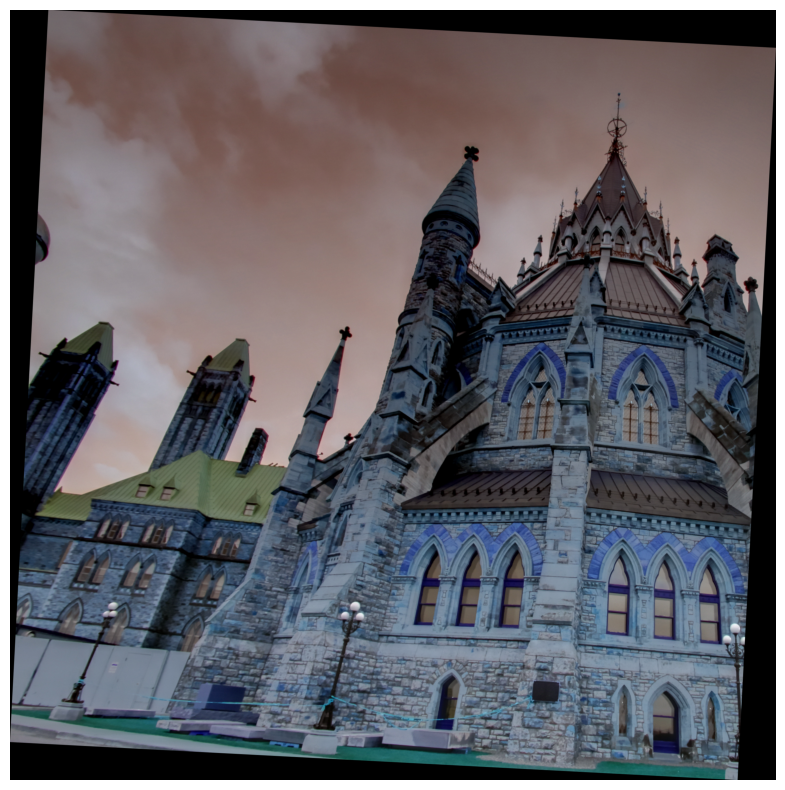

In [ ]:
#The Affine transformation cuts off image 1 as seen above, as such we need to find the portion not removed, and add that to the panorama
#This starts by finding the full image with the applied transformation

#Warp image1 using the best estimated transformation
#Adjusted to include translation to prevent cutting off
#Calculate translation to ensure entire transformed image fits
h1, w1 = image1.shape[:2]
h2, w2 = image2.shape[:2]
corners = np.array([[0, 0, 1], [w1, 0, 1], [0, h1, 1], [w1, h1, 1]])
transformed_corners = np.dot(corners, best_model.T)
x_min = int(np.min(transformed_corners[:, 0]))
x_max = int(np.max(transformed_corners[:, 0]))
y_min = int(np.min(transformed_corners[:, 1]))
y_max = int(np.max(transformed_corners[:, 1]))
translation_matrix = np.array([[1, 0, -x_min], [0, 1, -y_min], [0, 0, 1]])
adjusted_model = np.dot(translation_matrix, best_model)

warped_image_test1 = cv2.warpPerspective(image1_new, adjusted_model, (x_max - x_min, y_max - y_min))

#Display the result
fig, ax = plt.subplots(figsize=(20, 10))
ax.imshow(warped_image_test1)
ax.axis('off')
plt.show()

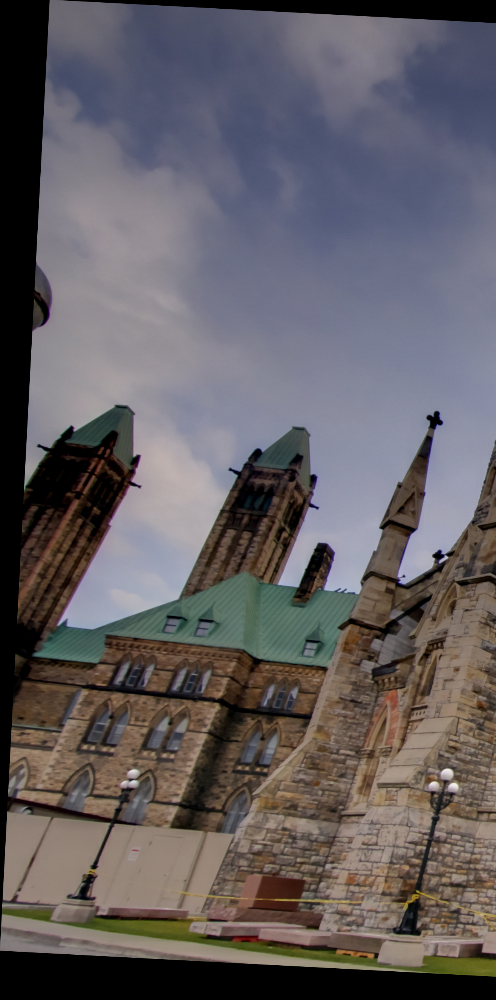

In [ ]:
#Get the width and height of the image
height, width =  warped_image_test1.shape[:2]

#Split the image down the middle horizontally
left_half = warped_image_test1[:, :width // 2]

#Display. May give visibility errors if not on Google Colab; just ignore and move to the next section
cv2_imshow(left_half)
cv2.waitKey(0)
cv2.destroyAllWindows()

(2649, 1316, 3)
(2575, 2556, 3)
(2575, 1279, 3)
(2575, 2556, 3)


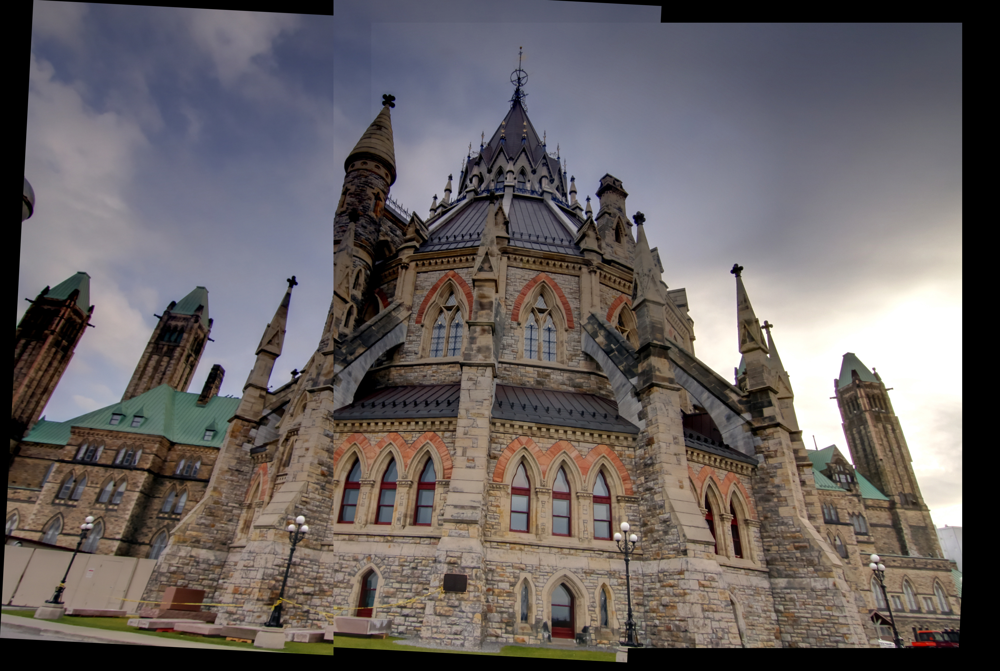

In [ ]:
#Check the shape of both images
print(left_half.shape)
print(panorama.shape)

#Get the heights of the images
height1, width1 = left_half.shape[:2]
height2, width2 = panorama.shape[:2]

#Resize image2 to match the height of image1
if height1 < height2:
    panorama = cv2.resize(panorama, (int(width2 * height1 / height2), height1))
else:
    left_half = cv2.resize(left_half, (int(width1 * height2 / height1), height2))

#Check the shape of both images
print(left_half.shape)
print(panorama.shape)

#Concatenate the images horizontally
vis = np.concatenate((left_half, panorama), axis=1)

#Display or download if you're not on colab
cv2.imwrite('Panorama.jpg',vis)
cv2_imshow(vis)
cv2.waitKey(0)
cv2.destroyAllWindows()